# Import Common Libraries

In [65]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D

# Read the dataset

In [3]:
df = pd.read_csv('D:\\Academics\\7th Semester\\SWE 4701 Software Metrices\\Assignment\\Software-Metric-Analysis\\Data\\jm1_cleaned.csv')

# Overview of the dataset

In [4]:
df.head(10)

,"McCabe ""line count of code""","McCabe ""cyclomatic complexity""","McCabe ""essential Complexity""","McCabe ""design complexity""","Halstead ""total operators + operands""","Halstead ""volume""","Halstead ""program length""","Halstead ""difficulty""","Halstead ""intelligence""","Halstead ""effort""",...,"Halstead ""line Count""","Halstead ""count of lines of comments""","Halstead ""count of blank lines""",locCodeAndComment,Unique operators,Unique operands,Total operators,Total operands,Count of all branches,Defects
0,1.1,1.4,1.4,1.4,1.3,1.30,1.30,1.30,1.30,1.30,...,2,2,2,2,1.2,1.2,1.2,1.2,1.4,False
1,1.0,1.0,1.0,1.0,1.0,1.00,1.00,1.00,1.00,1.00,...,1,1,1,1,1.0,1.0,1.0,1.0,1.0,True
2,72.0,7.0,1.0,6.0,198.0,1134.13,0.05,20.31,55.85,23029.10,...,51,10,8,1,17.0,36.0,112.0,86.0,13.0,True
3,190.0,3.0,1.0,3.0,600.0,4348.76,0.06,17.06,254.87,74202.67,...,129,29,28,2,17.0,135.0,329.0,271.0,5.0,True
4,37.0,4.0,1.0,4.0,126.0,599.12,0.06,17.19,34.86,10297.30,...,28,1,6,0,11.0,16.0,76.0,50.0,7.0,True
5,31.0,2.0,1.0,2.0,111.0,582.52,0.08,12.25,47.55,7135.87,...,19,0,5,0,14.0,24.0,69.0,42.0,3.0,True
6,78.0,9.0,5.0,4.0,0.0,0.00,0.00,0.00,0.00,0.00,...,0,0,0,0,0.0,0.0,0.0,0.0,17.0,True
7,8.0,1.0,1.0,1.0,16.0,50.72,0.36,2.80,18.11,142.01,...,5,0,1,0,4.0,5.0,9.0,7.0,1.0,True
8,24.0,2.0,1.0,2.0,0.0,0.00,0.00,0.00,0.00,0.00,...,0,0,0,0,0.0,0.0,0.0,0.0,3.0,True
9,143.0,22.0,20.0,10.0,0.0,0.00,0.00,0.00,0.00,0.00,...,0,0,0,0,0.0,0.0,0.0,0.0,43.0,True


## Attributes of the dataset

In [5]:
df.describe()

,"McCabe ""line count of code""","McCabe ""cyclomatic complexity""","McCabe ""essential Complexity""","McCabe ""design complexity""","Halstead ""total operators + operands""","Halstead ""volume""","Halstead ""program length""","Halstead ""difficulty""","Halstead ""intelligence""","Halstead ""effort""",...,"Halstead ""time estimator""","Halstead ""line Count""","Halstead ""count of lines of comments""","Halstead ""count of blank lines""",locCodeAndComment,Unique operators,Unique operands,Total operators,Total operands,Count of all branches
count,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.00000,1.088000e+04,...,1.088000e+04,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000
mean,42.020138,6.347739,3.400037,4.001415,114.391388,673.772003,0.135352,14.177339,29.43885,3.684563e+04,...,2.046980e+03,26.253125,2.738787,4.625092,0.370956,11.177592,16.751857,68.110588,46.388989,11.292316
std,76.608641,13.021924,6.772697,9.118682,249.549291,1939.253379,0.160552,18.712325,34.42332,4.344671e+05,...,2.413706e+04,59.622819,9.010486,9.969914,1.908391,10.045255,26.667883,151.513836,100.351845,22.597617
min,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000e+00,...,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,11.000000,2.000000,1.000000,1.000000,14.000000,48.430000,0.030000,3.000000,11.86000,1.619400e+02,...,9.000000e+00,4.000000,0.000000,0.000000,0.000000,5.000000,4.000000,8.000000,6.000000,3.000000
50%,23.000000,3.000000,1.000000,2.000000,49.000000,217.130000,0.080000,9.090000,21.92500,2.031020e+03,...,1.128300e+02,13.000000,0.000000,2.000000,0.000000,11.000000,11.000000,29.000000,19.000000,5.000000
75%,46.000000,7.000000,3.000000,4.000000,119.000000,620.850000,0.160000,18.902500,36.78000,1.141615e+04,...,6.342350e+02,28.000000,2.000000,5.000000,0.000000,16.000000,21.000000,71.000000,48.000000,13.000000
max,3442.000000,470.000000,165.000000,402.000000,8441.000000,80843.080000,1.300000,418.200000,569.78000,3.107978e+07,...,1.726655e+06,2824.000000,344.000000,447.000000,108.000000,411.000000,1026.000000,5420.000000,3021.000000,826.000000


## Column datatype and null value information

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10880 entries, 0 to 10879
Data columns (total 22 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   McCabe "line count of code"            10880 non-null  float64
 1   McCabe "cyclomatic complexity"         10880 non-null  float64
 2   McCabe "essential Complexity"          10880 non-null  float64
 3   McCabe "design complexity"             10880 non-null  float64
 4   Halstead "total operators + operands"  10880 non-null  float64
 5   Halstead "volume"                      10880 non-null  float64
 6   Halstead "program length"              10880 non-null  float64
 7   Halstead "difficulty"                  10880 non-null  float64
 8   Halstead "intelligence"                10880 non-null  float64
 9   Halstead "effort"                      10880 non-null  float64
 10  Halstead "bugs"                        10880 non-null  float64
 11  Ha

# Exploratory Data Analysis (EDA)

## Count the target feature

We check whether the dataset is balanced. By "balanced", we mean whether the distribution of the target/label values is equal or not.

In [7]:
df['Defects'].value_counts()

Defects
False    8777
True     2103
Name: count, dtype: int64

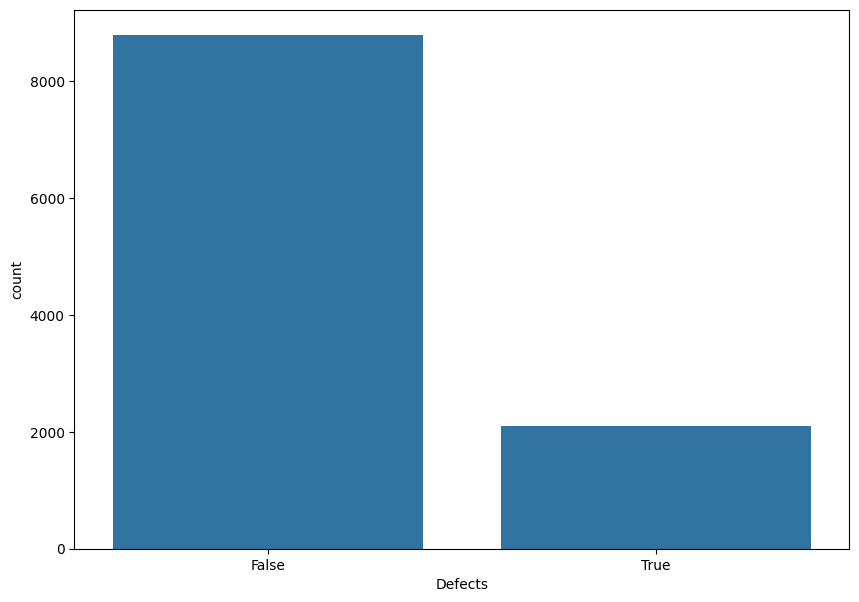

In [8]:
fig,ax = plt.subplots(figsize=(10,7))
sns.countplot(x='Defects', data=df,ax=ax)
plt.show()

From the above data and visualization, we can see that the dataset is highly imbalanced. The amount of False values is much higher than the True values in the target label.

## Skewness and Boxplot Analysis

### Skewness

#### Definition

Skewness is a measure of the asymmetry of the probability distribution of a real-valued random variable about its mean. The skewness value can be positive, zero, negative, or undefined.

- **Positive Skewness** means when the tail on the right side of the distribution is longer or fatter. The mean and median will be greater than the mode.
- **Negative Skewness** is when the tail of the left side of the distribution is longer or fatter than the tail on the right side. The mean and median will be less than the mode.

The formula for skewness is:

```
Skewness = E[(X - μ)^3] / σ^3
```

Where:
- E is the expectation operator.
- X is a random variable.
- μ is the mean.
- σ is the standard deviation.




#### Code

In [9]:
for column in df.columns[:-1]:
    skewness = df[column].skew()
    if skewness > 0:
        skewness_type = 'Positive skewness'
    elif skewness < 0:
        skewness_type = 'Negative skewness'
    else:
        skewness_type = 'Approximately symmetric'
    print(f'Skewness of {column}: {skewness} ({skewness_type})')

Skewness of McCabe "line count of code": 14.824014875023604 (Positive skewness)
Skewness of McCabe "cyclomatic complexity": 15.217387005424467 (Positive skewness)
Skewness of McCabe "essential Complexity": 8.18665642192353 (Positive skewness)
Skewness of McCabe "design complexity": 21.47964144363008 (Positive skewness)
Skewness of Halstead "total operators + operands": 10.489602985060051 (Positive skewness)
Skewness of Halstead "volume": 15.663414359563024 (Positive skewness)
Skewness of Halstead "program length": 1.9206586604494102 (Positive skewness)
Skewness of Halstead "difficulty": 6.018033573889237 (Positive skewness)
Skewness of Halstead "intelligence": 5.152927126213061 (Positive skewness)
Skewness of Halstead "effort": 46.20162170150418 (Positive skewness)
Skewness of Halstead "bugs": 15.656479385083276 (Positive skewness)
Skewness of Halstead "time estimator": 46.20162186997612 (Positive skewness)
Skewness of Halstead "line Count": 17.62678005567693 (Positive skewness)
Skewne

#### Conclusion

The skewness analysis of the various features in the dataset reveals that all features exhibit positive skewness. This indicates that for all these features, the tail on the right side of the distribution is longer or fatter. In other words, the majority of the values are concentrated on the left side of the distribution (lower values), with a few exceptionally high values pulling the mean towards the right.

The features with the highest skewness are 'Halstead "effort"' and 'Halstead "time estimator"', suggesting these features have a few extremely high values. 

On the other hand, the feature 'Halstead "program length"' has the least skewness among all, indicating that its distribution is closer to a normal distribution compared to the other features, although it's still positively skewed.

This skewness analysis provides valuable insights into the distribution of the data and can guide further data preprocessing steps, such as outlier detection and handling, and data transformation to reduce skewness if required.

### Boxplot

#### Definition

A **Boxplot** is a standardized way of displaying the dataset based on a five-number summary: the minimum, the maximum, the sample median, and the first and third quartiles.

- **Minimum** : the lowest data point excluding any outliers.
- **Maximum** : the largest data point excluding any outliers.
- **Median (Q2 / 50th Percentile)** : the middle value of the dataset.
- **First quartile (Q1 / 25th Percentile)** : also known as the lower quartile qn(0.25), is the median of the lower half of the dataset.
- **Third quartile (Q3 / 75th Percentile)** : also known as the upper quartile qn(0.75), is the median of the upper half of the dataset.

An important element of a box plot is the **Interquartile Range (IQR)**, which is the range between the first quartile (25th percentile) and the third quartile (75th percentile). It is used to build the boxplot and also to detect outliers:

```
IQR = Q3 - Q1
```

Boxplots are great to give an overview and compare distributions, for example, comparing groups of a categorical variable in terms of a continuous variable.
```

#### Code

In [10]:
for column in df.columns[:-1]:
    fig = go.Figure()
    fig.add_trace(go.Box(y=df[df['Defects'] == True][column], name='True'))
    fig.add_trace(go.Box(y=df[df['Defects'] == False][column], name='False'))
    fig.add_trace(go.Box(y=df[column], name='All'))
    fig.update_layout(title='Box Plot of ' + column, xaxis_title='Defects', yaxis_title=column)
    fig.show()

#### Conclusion

From the boxplots, it's clear that there is a significant variation in the range and distribution of values across different features. Some features have a wide range of values, as indicated by the length of the boxes and whiskers, while others have a more narrow range.

The boxplots also reveal the presence of outliers in several features. These are represented by points that fall outside the whiskers of the boxplots. The features with the most outliers will need to be investigated further, as these outliers can significantly impact the results of any subsequent analysis.

The feature 'Halstead "effort"' and 'Halstead "time estimator"' appear to have a significant number of outliers, which is consistent with the high skewness observed for these features.

In contrast, the feature 'Halstead "program length"' appears to have fewer outliers, which aligns with its lower skewness value.

## Barplot

#### Definition

A bar plot or bar chart is a chart or graph that presents categorical data with rectangular bars with heights or lengths proportional to the values that they represent. The bars can be plotted vertically or horizontally.

Bar plots are used when you want to:
- Compare a single category of data between individual subgroups of data.
- Visualize categorical data that has been split into multiple categories.
- Show the frequency of different categories of data.

Bar plots can also be useful for presenting data that include categories with values that are very different from each other, or for data with categories that are not in a particular order.

#### Code

In [11]:
for column in df.columns[:-1]:
    fig = go.Figure()
    fig.add_trace(go.Bar(x=['True'], y=[df[df['Defects'] == True][column].mean()], name='True'))
    fig.add_trace(go.Bar(x=['False'], y=[df[df['Defects'] == False][column].mean()], name='False'))
    fig.update_layout(title='Bar Plot of ' + column, xaxis_title='Defects', yaxis_title=column)
    fig.show()

#### Conclusion

 The results suggest that when 'Defects' is True, the mean values of all features are higher. This indicates that longer, more complex code, which requires more effort and time to develop, is more likely to have defects. 

## Scatterplot

#### Definition

A scatter plot (also known as a scatterplot, scatter graph, scatter chart, scattergram, or scatter diagram) is a type of plot or mathematical diagram using Cartesian coordinates to display values for typically two variables for a set of data. The data are displayed as a collection of points, each having the value of one variable determining the position on the horizontal axis and the value of the other variable determining the position on the vertical axis. This kind of plot is useful to see complex correlations between two variables. Points could be coded by color or shape for additional variables.

#### Code

For a scatterplot, we take two lists of features. One list will contain the McCabe features/columns, and another list will contain the Halstead features/columns.

In [12]:
mccabe_features = ['McCabe "line count of code"', 'McCabe "cyclomatic complexity"', 'McCabe "essential Complexity"', 'McCabe "design complexity"']

halstead_features = ['Halstead "total operators + operands"', 'Halstead "volume"', 'Halstead "program length"', 'Halstead "difficulty"', 'Halstead "intelligence"', 'Halstead "effort"', 'Halstead "bugs"', 'Halstead "time estimator"']

Now we plot the values of features of McCabe with Halstead. We make sure that the visulaization is proper and understandable. 

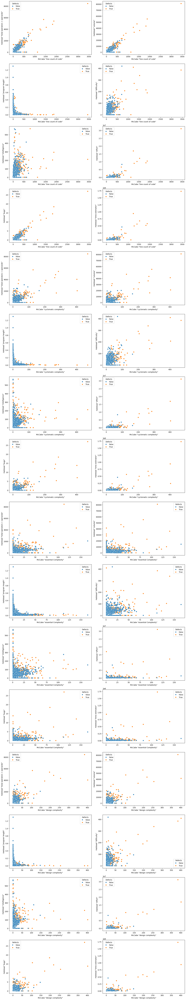

In [13]:
n_plots = len(mccabe_features) * len(halstead_features)

n_rows = n_plots // 2
if n_plots % 2:
    n_rows += 1

fig, axs = plt.subplots(nrows=n_rows, ncols=2, figsize=(15, n_rows*5))

plot_counter = 0

for mccabe_feature in mccabe_features:
    for halstead_feature in halstead_features:
        row = plot_counter // 2
        col = plot_counter % 2
        sns.scatterplot(data=df, x=mccabe_feature, y=halstead_feature, hue='Defects', ax=axs[row, col])
        plot_counter += 1

plt.tight_layout()
plt.show()

#### Conclusion

Upon analyzing the scatterplot of the dataset, which includes McCabe and Halstead features, we observe a trend where an increase in these values corresponds to an increase in the number of true defects. This trend is particularly pronounced for values situated on the upper and right side of the graph.

However, there are notable exceptions. For the Halstead features "intelligence" and "program length", the number of defects tends to decrease as long as the complexity remains low. This suggests that software developed intelligently and with minimal complexity is less likely to have defects. The same principle applies to program length. Even if the software has a high program length, maintaining low complexity within the code can significantly reduce the likelihood of defects.

## Measures of Association

A measure of association is a statistical term that refers to a wide variety of coefficients that measure the statistical strength and direction of a relationship between two or more variables. The value of a measure of association can tell us the degree to which two variables are related and the direction of their relationship.

### Correlation

#### Definition

Correlation is a statistical measure that describes the degree to which two variables move in relation to each other. It's used to quantify the degree to which two variables are related.

Correlation values range between -1 and 1.
- A correlation of 1 indicates a perfect positive correlation, meaning both variables move in the same direction together.
- A correlation of -1 indicates a perfect negative correlation, meaning both variables move in opposite directions.
- A correlation of 0 indicates no correlation, meaning the variables do not have a linear relationship with each other.

In general, the default method used in correlation is the `Pearson` method.

The formula for Pearson's correlation coefficient is:

r = Σ[(x<sub>i</sub> - x̄)(y<sub>i</sub> - ȳ)] / sqrt[(Σ(x<sub>i</sub> - x̄)²)(Σ(y<sub>i</sub> - ȳ)²)]

Where:
- r is the Pearson correlation coefficient
- x<sub>i</sub>, y<sub>i</sub> are the individual sample points indexed with i
- x̄ is the mean of the x sample points
- ȳ is the mean of the y sample points
- Σ is the sum from i=1 to n
- sqrt is the square root function 

#### Code (Viewing the correlation of features in a tabular form)

The default correlation method used by the pandas library is the `Pearson method`. Alternatively, we can manually specify this method as a parameter for the `corr()` function like this: `method='pearson'`.

In [14]:
correlation = df.corr()
correlation

,"McCabe ""line count of code""","McCabe ""cyclomatic complexity""","McCabe ""essential Complexity""","McCabe ""design complexity""","Halstead ""total operators + operands""","Halstead ""volume""","Halstead ""program length""","Halstead ""difficulty""","Halstead ""intelligence""","Halstead ""effort""",...,"Halstead ""line Count""","Halstead ""count of lines of comments""","Halstead ""count of blank lines""",locCodeAndComment,Unique operators,Unique operands,Total operators,Total operands,Count of all branches,Defects
"McCabe ""line count of code""",1.000000,0.817795,0.517599,0.784060,0.881790,0.900290,-0.286592,0.689529,0.499926,0.750578,...,0.921915,0.612873,0.803572,0.278119,0.536681,0.764622,0.880967,0.868275,0.830194,0.245437
"McCabe ""cyclomatic complexity""",0.817795,1.000000,0.701673,0.859591,0.730810,0.759910,-0.252825,0.669091,0.303072,0.709539,...,0.799949,0.384557,0.538381,0.209838,0.647430,0.700514,0.744164,0.696078,0.971958,0.208670
"McCabe ""essential Complexity""",0.517599,0.701673,1.000000,0.639572,0.466024,0.445931,-0.233862,0.434036,0.213267,0.315572,...,0.454634,0.294292,0.338253,0.190962,0.263000,0.337031,0.479935,0.435518,0.785553,0.172935
"McCabe ""design complexity""",0.784060,0.859591,0.639572,1.000000,0.702411,0.743192,-0.197696,0.575354,0.309715,0.757721,...,0.775872,0.351609,0.541284,0.207040,0.500750,0.617966,0.715244,0.668940,0.858994,0.181981
"Halstead ""total operators + operands""",0.881790,0.730810,0.466024,0.702411,1.000000,0.984277,-0.240736,0.808101,0.651189,0.716556,...,0.944380,0.596409,0.798548,0.284404,0.610412,0.836171,0.995689,0.989484,0.747894,0.204087
"Halstead ""volume""",0.900290,0.759910,0.445931,0.743192,0.984277,1.000000,-0.198092,0.752202,0.598730,0.800013,...,0.962077,0.576869,0.792323,0.266544,0.606993,0.852296,0.981565,0.971960,0.759971,0.189113
"Halstead ""program length""",-0.286592,-0.252825,-0.233862,-0.197696,-0.240736,-0.198092,1.000000,-0.347213,-0.166792,-0.062034,...,-0.218360,-0.165945,-0.223636,-0.106154,-0.305331,-0.234892,-0.237325,-0.241023,-0.279126,-0.164721
"Halstead ""difficulty""",0.689529,0.669091,0.434036,0.575354,0.808101,0.752202,-0.347213,1.000000,0.398085,0.574341,...,0.768175,0.502181,0.637171,0.253819,0.749305,0.639686,0.817546,0.777732,0.671976,0.169442
"Halstead ""intelligence""",0.499926,0.303072,0.213267,0.309715,0.651189,0.598730,-0.166792,0.398085,1.000000,0.209277,...,0.563897,0.392598,0.572311,0.217834,0.391646,0.726696,0.620676,0.687891,0.325796,0.192643
"Halstead ""effort""",0.750578,0.709539,0.315572,0.757721,0.716556,0.800013,-0.062034,0.574341,0.209277,1.000000,...,0.809090,0.384808,0.600673,0.148690,0.482061,0.586805,0.735802,0.673490,0.667886,0.086092


#### Code (Visualizing the correlation table)

In [15]:
mask = np.triu(np.ones_like(correlation, dtype=bool))

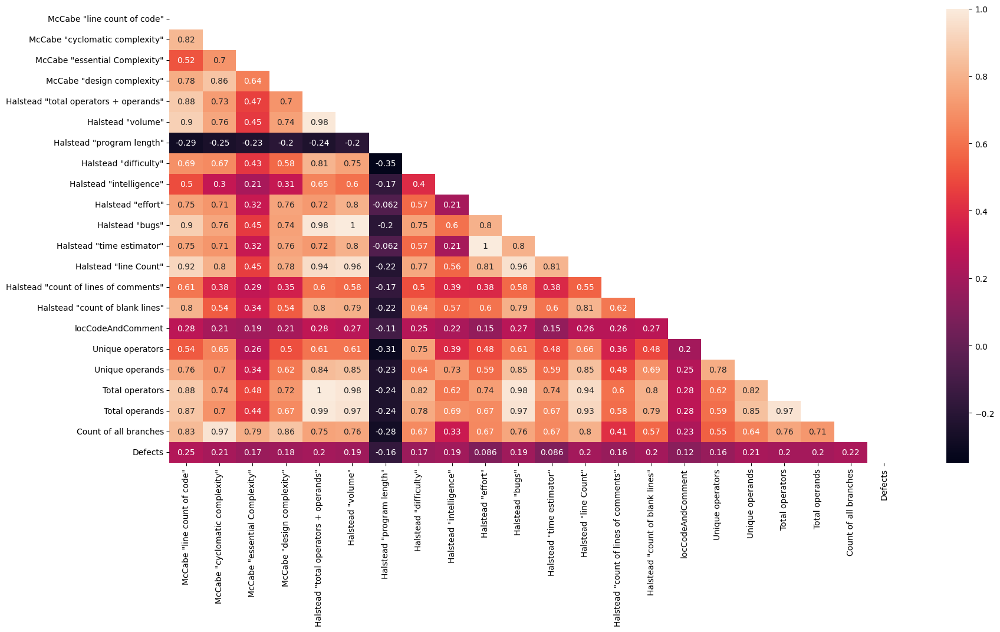

In [16]:
fig, ax = plt.subplots(figsize=(20, 10))
correlationMatrix = sns.heatmap(correlation, mask=mask, annot=True, ax=ax)

#### Conclusion

The Pearson correlation analysis reveals several strong relationships between the variables. For instance, 'Halstead "total operators + operands"' and 'Total operators' show a very high positive correlation, indicating that as one increases, the other tends to as well. Similarly, 'Halstead "volume"' and 'Halstead "bugs"' are highly positively correlated. 

However, 'Halstead "program length"' shows a negative correlation with most of the other variables, suggesting that as the program length increases, these other metrics tend to decrease. 

The 'Defects' column, which could be of particular interest, shows low correlation with all the other metrics, indicating that these variables might not be good predictors for defects.

### Spearman's Rank Correlation

#### Definition

Spearman's Rank Correlation is a non-parametric test used to measure the degree of association between two variables. It's a statistic used in the field of statistics to measure the strength and direction of the monotonic relationship between two ranked variables.

The Spearman correlation between two variables is equal to the Pearson correlation between the rank values of those two variables. While Pearson's correlation assesses linear relationships, Spearman's correlation assesses monotonic relationships (whether linear or not).

The formula for Spearman's Rank Correlation is:


ρ = 1 - (6 * Σd<sub>i</sub><sup>2</sup>) / (n * (n<sup>2</sup> - 1))


Where:
- `ρ` is the Spearman rank correlation
- `di` is the difference between the ranks of corresponding variables
- `n` is the number of observations

#### Code (Viewing the correlation of features in a tabular form)

The default correlation method used by the pandas library is the `Pearson method`. If you want to use the `Spearman rank` correlation method instead, you can specify this as a parameter for the `corr()` function like this: `method='spearman'`.

In [17]:
correlation_using_spearman = df.corr(method='spearman')
correlation_using_spearman

,"McCabe ""line count of code""","McCabe ""cyclomatic complexity""","McCabe ""essential Complexity""","McCabe ""design complexity""","Halstead ""total operators + operands""","Halstead ""volume""","Halstead ""program length""","Halstead ""difficulty""","Halstead ""intelligence""","Halstead ""effort""",...,"Halstead ""line Count""","Halstead ""count of lines of comments""","Halstead ""count of blank lines""",locCodeAndComment,Unique operators,Unique operands,Total operators,Total operands,Count of all branches,Defects
"McCabe ""line count of code""",1.000000,0.808860,0.487479,0.746113,0.672962,0.674841,-0.725528,0.613904,0.548251,0.665694,...,0.698678,0.546519,0.677846,0.320938,0.583537,0.634712,0.671696,0.669709,0.806863,0.296057
"McCabe ""cyclomatic complexity""",0.808860,1.000000,0.688675,0.832188,0.534404,0.538211,-0.709418,0.570545,0.338990,0.563884,...,0.558665,0.378391,0.461993,0.294408,0.574016,0.474216,0.537574,0.525684,0.997288,0.238918
"McCabe ""essential Complexity""",0.487479,0.688675,1.000000,0.520647,0.283727,0.287007,-0.495651,0.333240,0.132300,0.313431,...,0.276044,0.253522,0.238147,0.197138,0.353692,0.234559,0.289067,0.273978,0.697638,0.164700
"McCabe ""design complexity""",0.746113,0.832188,0.520647,1.000000,0.530650,0.536282,-0.574172,0.509337,0.427182,0.536504,...,0.548295,0.374706,0.465843,0.281896,0.527113,0.519849,0.528953,0.529979,0.830912,0.243118
"Halstead ""total operators + operands""",0.672962,0.534404,0.283727,0.530650,1.000000,0.999257,-0.282711,0.944343,0.880549,0.991098,...,0.971312,0.577541,0.857672,0.357139,0.904094,0.953879,0.998055,0.995489,0.533654,0.172219
"Halstead ""volume""",0.674841,0.538211,0.287007,0.536282,0.999257,1.000000,-0.279669,0.941327,0.885947,0.990241,...,0.972202,0.577879,0.859586,0.357781,0.911023,0.961477,0.996994,0.995413,0.537252,0.174455
"Halstead ""program length""",-0.725528,-0.709418,-0.495651,-0.574172,-0.282711,-0.279669,1.000000,-0.338397,-0.039416,-0.316632,...,-0.260143,-0.246787,-0.271195,-0.186784,-0.287811,-0.175208,-0.288053,-0.268741,-0.711295,-0.194787
"Halstead ""difficulty""",0.613904,0.570545,0.333240,0.509337,0.944343,0.941327,-0.338397,1.000000,0.701179,0.978355,...,0.920806,0.537958,0.807376,0.345484,0.949347,0.837037,0.949473,0.930566,0.570827,0.144535
"Halstead ""intelligence""",0.548251,0.338990,0.132300,0.427182,0.880549,0.885947,-0.039416,0.701179,1.000000,0.819747,...,0.858074,0.508898,0.765895,0.297401,0.712021,0.957882,0.869026,0.891695,0.336198,0.160787
"Halstead ""effort""",0.665694,0.563884,0.313431,0.536504,0.991098,0.990241,-0.316632,0.978355,0.819747,1.000000,...,0.964743,0.570831,0.850014,0.358622,0.938008,0.922511,0.991874,0.983052,0.563467,0.166625


#### Code (Visualizing the correlation table)

In [18]:
mask = np.triu(np.ones_like(correlation_using_spearman, dtype=bool))

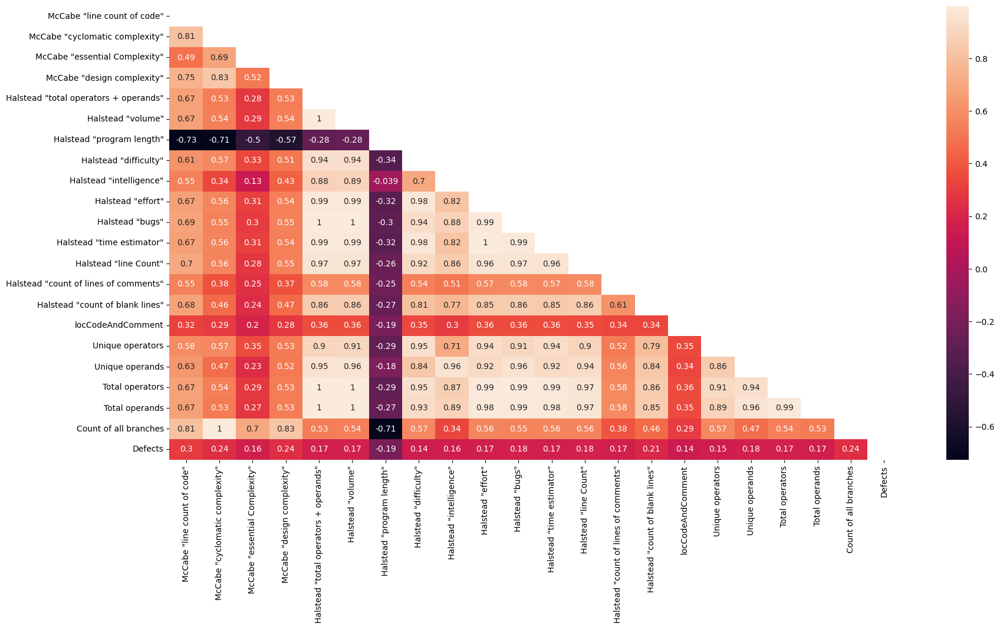

In [19]:
fig, ax = plt.subplots(figsize=(20, 10))
correlationMatrix = sns.heatmap(correlation_using_spearman, mask=mask, annot=True, ax=ax)

#### Conclusion

Based on the correlation matrix, it appears that many of the metrics have strong correlations with each other. For instance, 'Halstead "total operators + operands"' has a very high correlation with 'Halstead "volume"', 'Halstead "difficulty"', 'Halstead "intelligence"', and 'Halstead "effort"'. This suggests that these metrics tend to increase or decrease together.

On the other hand, 'Halstead "program length"' has a negative correlation with many of the metrics, indicating that as the program length increases, these metrics tend to decrease, and vice versa.

The 'Defects' column, which might represent the number of bugs or errors in the code, has relatively low correlation values with all the metrics. This suggests that none of these metrics is a strong predictor of the number of defects.

## Regression Analysis

Regression analysis is a statistical method used to determine the relationship between a dependent variable (commonly referred to as the 'target variable') and one or more independent variables (often termed as 'predictors' or 'features'). This technique is extensively used for making predictions and forecasts, and its application significantly intersects with the domain of machine learning.

### Linear Regression

#### Definition

Linear regression is a statistical method used to model the relationship between a dependent variable (often denoted as `y`) and one or more independent variables (often denoted as `x`).

The formula for simple linear regression (one independent variable) is:

`y = c + m*x + e`

Where:
- `y` is the dependent variable.
- `x` is the independent variable.
- `c` is the y-intercept (value of `y` when `x` is 0).
- `m` is the slope of the line (change in `y` for each unit change in `x`).
- `e` is the error term (difference between the observed and predicted values).

The drawback of this method is that it is sensitive to outliers. If there are outliers in the data, the line of best fit will be skewed towards the outliers. This will result in a poor fit for the data. Also, real world data may not be linear, hence this method may not be suitable for all data.

#### Code (Generates Coefficients)

We will use the `LinearRegression()` function from the `sklearn.linear_model` library to perform the linear regression.

In [20]:
from sklearn.linear_model import LinearRegression

Our objective is to visualize and analyze the data, rather than making predictions using the Linear Regression model. Therefore, we utilize the McCabe and Halstead features to generate a linear regression line. This line is produced using coefficients derived from the model.

In [21]:
mccabe_features = ['McCabe "line count of code"', 'McCabe "cyclomatic complexity"', 'McCabe "essential Complexity"', 'McCabe "design complexity"']

halstead_features = ['Halstead "total operators + operands"', 'Halstead "volume"', 'Halstead "program length"', 'Halstead "difficulty"', 'Halstead "intelligence"', 'Halstead "effort"', 'Halstead "bugs"', 'Halstead "time estimator"']

We instantiate a `results` dictionary to hold the coefficients that will be produced by the Linear Regression model.

In [22]:
results = {}

Generating the coefficient values utilizing the Linear Regression model.

In [23]:
for mccabe_feature in mccabe_features:
    for halstead_feature in halstead_features:
        X = df[[mccabe_feature]]    
        y = df[halstead_feature]
        model = LinearRegression().fit(X, y)
        key = f'{mccabe_feature} and {halstead_feature}'
        results[key] = {
            'score': model.score(X, y),
            'equation': f'{model.coef_[0]}x + {model.intercept_}'
        }

Compilation of coefficient values corresponding to their respective features.

In [24]:
for key, value in results.items():
    print(f'{key}: {value}\n')    

McCabe "line count of code" and Halstead "total operators + operands": {'score': 0.7775541681244342, 'equation': '2.8723933084880096x + -6.30697496512596'}

McCabe "line count of code" and Halstead "volume": {'score': 0.8105220739754635, 'equation': '22.789732092598292x + -283.8556817403679'}

McCabe "line count of code" and Halstead "program length": {'score': 0.08213497805293879, 'equation': '-0.0006006216771902149x + 0.1605902277406538'}

McCabe "line count of code" and Halstead "difficulty": {'score': 0.4754508221128685, 'equation': '0.16842354072942448x + 7.100158752804079'}

McCabe "line count of code" and Halstead "intelligence": {'score': 0.24992621927243863, 'equation': '0.22463680176243642x + 19.99958080361865'}

McCabe "line count of code" and Halstead "effort": {'score': 0.5633667125292438, 'equation': '4256.716963088734x + -142022.204414489'}

McCabe "line count of code" and Halstead "bugs": {'score': 0.8099311291369315, 'equation': '0.00759524838782212x + -0.0943831638070

#### Code (Visualizes the line of Linear regression)

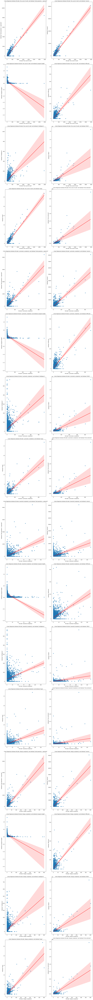

In [25]:
fig, axs = plt.subplots(len(results)//2, 2, figsize=(15, len(results)*5))

for ax, (key, value) in zip(axs.flatten(), results.items()):
    mccabe_feature, halstead_feature = key.split(' and ')
    sns.regplot(x=mccabe_feature, y=halstead_feature, data=df, ax=ax, line_kws={'color': 'red'})
    ax.set_title(f'Linear Regression between {mccabe_feature} and {halstead_feature}', fontsize=10)

plt.tight_layout()
plt.show()

#### Conclusion

From a visualization perspective, we observe that the 'program length' feature from Halstead results in a negative slope for the linear regression line. Apart from this, it's generally understood that the linear regression line typically exhibits a positive slope.

### Robust Regression

#### Definition

Robust regression is a form of regression analysis that is designed to circumvent some limitations of traditional parametric and non-parametric methods. It's particularly useful in the presence of outliers or heteroscedasticity in the data, where traditional regression models could be inefficient or provide misleading results.

The general formula for a linear regression is `y = mX + e`, where `y` is the dependent variable, `X` is the matrix of independent variables, `m` is the vector of coefficients we want to estimate, and `e` is the error term.

In a robust regression, the goal is to minimize a function that is less sensitive to outliers than the sum of squared residuals. One common choice is [Huber's function](https://en.wikipedia.org/wiki/Huber_loss), which is quadratic for small residuals and linear for large residuals. The problem then becomes to minimize:

`∑ ρ(y - mX)`

where `ρ` is a function that grows slower than the square, for instance the absolute value or Huber's function. The exact form of `ρ` determines the specific type of robust regression.

The drawback of this technique is that it can be complex and difficult to implement, as well as computationally demanding and time-consuming. Moreover, they may be less efficient or precise than [OLS regression](https://en.wikipedia.org/wiki/Ordinary_least_squares) when the data does not contain outliers or influential observations, or when the assumptions of OLS are met by the data. Additionally, they can be sensitive to the choice of technique, loss function, tuning parameter, or initial estimate, which can affect the performance and results of the robust regression.

#### Code (Generates Coefficients) 

Like in the case of linear regression, we will use the `HuberRegressor()` function from the `sklearn.linear_model` library to perform the robust regression.

In [26]:
from sklearn.linear_model import HuberRegressor

Like in the case of linear regression, our objective is to visualize and analyze the data, rather than making predictions using the Robust Regression model. Therefore, we utilize the McCabe and Halstead features to generate a linear regression line. This line is produced using coefficients derived from the model.

In [27]:
mccabe_features = ['McCabe "line count of code"', 'McCabe "cyclomatic complexity"', 'McCabe "essential Complexity"', 'McCabe "design complexity"']

halstead_features = ['Halstead "total operators + operands"', 'Halstead "volume"', 'Halstead "program length"', 'Halstead "difficulty"', 'Halstead "intelligence"', 'Halstead "effort"', 'Halstead "bugs"', 'Halstead "time estimator"']

We instantiate a `results` dictionary to hold the coefficients that will be produced by the Robust Regression model.

In [28]:
results = {}

Generating the coefficient values utilizing the Robust Regression model.

In [29]:
for mccabe_feature in mccabe_features:
    for halstead_feature in halstead_features:
        X = df[[mccabe_feature]]    
        y = df[halstead_feature]
        model = HuberRegressor().fit(X, y)
        key = f'{mccabe_feature} and {halstead_feature}'
        results[key] = {
            'score': model.score(X, y),
            'equation': f'{model.coef_[0]}x + {model.intercept_}'
        }

Compilation of coefficient values corresponding to their respective features.

In [30]:
for key, value in results.items():
    print(f'{key}: {value}\n')    

McCabe "line count of code" and Halstead "total operators + operands": {'score': 0.7762486231904862, 'equation': '2.978259506174322x + -6.81533766168486'}

McCabe "line count of code" and Halstead "volume": {'score': 0.7884813364668118, 'equation': '19.0323496183293x + -120.29302057468902'}

McCabe "line count of code" and Halstead "program length": {'score': 0.002994604399784162, 'equation': '-0.0006912332221272167x + 0.11977018865852848'}

McCabe "line count of code" and Halstead "difficulty": {'score': 0.4270473929571751, 'equation': '0.2217026757318875x + 4.324067836600472'}

McCabe "line count of code" and Halstead "intelligence": {'score': 0.18271697498135608, 'equation': '0.3399284397894073x + 13.878179756923982'}

McCabe "line count of code" and Halstead "effort": {'score': 0.15207616989333939, 'equation': '627.788334428919x + -8183.972492512585'}

McCabe "line count of code" and Halstead "bugs": {'score': 0.7880352289870988, 'equation': '0.006346625501106073x + -0.040222499596

#### Code (Visualizes the line of Rrobust regression)

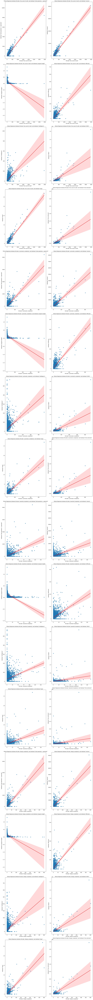

In [31]:
fig, axs = plt.subplots(len(results)//2, 2, figsize=(15, len(results)*5))

for ax, (key, value) in zip(axs.flatten(), results.items()):
    mccabe_feature, halstead_feature = key.split(' and ')
    sns.regplot(x=mccabe_feature, y=halstead_feature, data=df, ax=ax, line_kws={'color': 'red'})
    ax.set_title(f'Robust Regression between {mccabe_feature} and {halstead_feature}', fontsize=10)

plt.tight_layout()
plt.show()

#### Conclusion

Upon visual inspection, we note that the 'program length' attribute from Halstead causes the linear regression line to slope negatively. Besides this, it's commonly accepted that the robust regression line usually has a positive slope. 

As a brief remark, it closely resembles the linear regression line with only slight modifications.

### Multivariate Regression

#### Definition

Multivariate regression is a statistical method used to understand the relationship between two or more predictors (independent variables) and the response (dependent variable). 

The general formula for a multivariate regression is:

`y = β0 + β1*X1 + β2*X2 + ... + βn*Xn + ε`

Where:
- `y` is the dependent variable.
- `β0` is the y-intercept.
- `β1, β2, ..., βn` are the coefficients of the independent variables `X1, X2, ..., Xn`.
- `ε` is the error term.

Each `β` coefficient represents the change in the mean response, `E(y)`, per unit increase in the associated predictor variable, when all the other predictors are held constant. For example, `β1` represents the change in `y` for each unit change in `X1`, while holding other predictors constant.

In a multivariate regression, each coefficient is calculated using a method called [Ordinary Least Squares (OLS)](https://en.wikipedia.org/wiki/Ordinary_least_squares). The goal of OLS is to minimize the sum of the squares of the differences between the observed and predicted values of the dependent variable.

 It can face issues like overfitting, where a complex model fits data noise instead of the trend, leading to poor performance. Multicollinearity, where independent variables are highly correlated, can lead to unstable estimates. The method also requires large datasets, and outliers can disproportionately affect the regression line. Lastly, it makes several assumptions, and if these are violated, it can lead to biased estimates.

#### Code (Generates Coefficients)

For Multivariate Regression, we utilize the linear regression model, similar to the previous method. The `LinearRegression()` function from `sklearn.linear_model` is invoked for this purpose.

In [37]:
from sklearn.linear_model import LinearRegression

Like in the case of linear regression and robust regression, our objective is to visualize and analyze the data, rather than making predictions using the Multivariate Regression model. Therefore, we utilize the McCabe and Halstead features to generate a linear regression line. This line is produced using coefficients derived from the model.

In [41]:
mccabe_features = ['McCabe "line count of code"', 'McCabe "cyclomatic complexity"', 'McCabe "essential Complexity"', 'McCabe "design complexity"']

halstead_features = ['Halstead "total operators + operands"', 'Halstead "volume"', 'Halstead "program length"', 'Halstead "difficulty"', 'Halstead "intelligence"', 'Halstead "effort"', 'Halstead "bugs"', 'Halstead "time estimator"']

We instantiate a `results` dictionary to hold the coefficients that will be produced by the Multivariate Regression model.

In [78]:
results = {}

Generating the coefficient values utilizing the Multivariate Regression model.

In [79]:
for i in range(len(mccabe_features)):
    for j in range(i+1, len(mccabe_features)):
        for halstead_feature in halstead_features:
            X = df[[mccabe_features[i], mccabe_features[j]]]    
            y = df[halstead_feature]
            model = LinearRegression().fit(X, y)
            key = f'{mccabe_features[i]} and {mccabe_features[j]} and {halstead_feature}'
            results[key] = {
                'score': model.score(X, y),
                'coefficient': model.coef_,
                'intercept': model.intercept_
            }

Compilation of coefficient values corresponding to their respective features.

In [80]:
for key, value in results.items():
    print(f'{key}: {value}\n')    

McCabe "line count of code" and McCabe "cyclomatic complexity" and Halstead "total operators + operands": {'score': 0.7778374591922019, 'coefficient': array([2.79448446, 0.56046045]), 'intercept': -6.590891008398472}

McCabe "line count of code" and McCabe "cyclomatic complexity" and Halstead "volume": {'score': 0.8122118105602911, 'coefficient': array([21.311107  , 10.63692877]), 'intercept': -289.2440989399506}

McCabe "line count of code" and McCabe "cyclomatic complexity" and Halstead "program length": {'score': 0.0831628978336727, 'coefficient': array([-0.00050514, -0.00068686]), 'intercept': 0.16093817342582356}

McCabe "line count of code" and McCabe "cyclomatic complexity" and Halstead "difficulty": {'score': 0.5088626530738031, 'coefficient': array([0.10497934, 0.45640467]), 'intercept': 6.868954912504245}

McCabe "line count of code" and McCabe "cyclomatic complexity" and Halstead "intelligence": {'score': 0.2837001434266617, 'coefficient': array([ 0.34197989, -0.84414239]), 

#### Code (Visualizes the line of Multivariate regression)

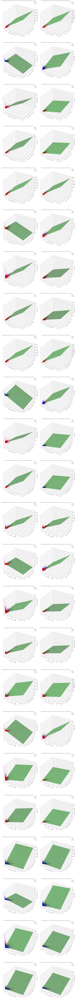

In [112]:
fig = plt.figure(figsize=(18, len(results)*5))

for i, (key, value) in enumerate(results.items()):
    mccabe_feature1, mccabe_feature2, halstead_feature = key.split(' and ')
    ax = fig.add_subplot(len(results)//2, 2, i+1, projection='3d')

    scatter_true = ax.scatter(df[df['Defects'] == True][mccabe_feature1], df[df['Defects'] == True][mccabe_feature2], df[df['Defects'] == True][halstead_feature], c='red', alpha=0.5, label='True')
    scatter_false = ax.scatter(df[df['Defects'] == False][mccabe_feature1], df[df['Defects'] == False][mccabe_feature2], df[df['Defects'] == False][halstead_feature], c='blue', alpha=0.5, label='False')

    x1 = np.linspace(df[mccabe_feature1].min(), df[mccabe_feature1].max(), num=10)
    x2 = np.linspace(df[mccabe_feature2].min(), df[mccabe_feature2].max(), num=10)
    x1, x2 = np.meshgrid(x1, x2)

    y_pred = value['intercept'] + value['coefficient'][0]*x1 + value['coefficient'][1]*x2
    
    ax.plot_surface(x1, x2, y_pred, color='green', alpha=0.5)

    ax.set_xlabel(mccabe_feature1, fontsize=9)
    ax.set_ylabel(mccabe_feature2, fontsize=9)
    ax.set_zlabel(halstead_feature, fontsize=9)
    ax.set_title(f'Multivariate Regression between {mccabe_feature1}, {mccabe_feature2} and {halstead_feature}', fontsize=8.5)

    legend = ax.legend()
    legend.set_title("Defect")

plt.tight_layout()
plt.show()

#### Conclusion

Upon visualizing the 3D plot, it becomes evident that as software complexity increases, so does the likelihood of defects. Other attributes such as lines of code, volume, and size also contribute to the potential for defects as their values increase. This observation aligns with our previous analysis. Interestingly, the 'program length' feature results in a negative slope of the regression line, consistent with our earlier visual analysis.

We can observe that if the software is crafted with intelligence and care by the developer, the rate of defects decreases. Furthermore, even if the software has a large size, if its complexity is well-managed, the rate of defects can be surprisingly low.